# AUPE Processing for Ries Crater Field Trip May 2025

A notebook for developing a processing library and pipeline for AUPE colour and multispectral image processing.

In this notebook we focus on extracting the Colour Correction Matrix from the Calibration Target.

We will also look at saving this colour correction matrix, so that other scenes can also use it.

Developed for processing of the Ries Crater field trip, May 2025.

R. Stabbins  
Natural History Museum, London, UK  
7/5/2025

# Overview

1. Set data input and output directories.
2. Read in WAC RGB and HRC images
3. Display WAC RGB and HRC images in colour, with 99p stretches
4. Run auto-calibration target detection on HRC RGB (large target)
5. Run auto-calibration target detection on WAC RGB (small target)
   1. Develop to work on this
6. Get masks for each patch, and save
7. Load mask, and apply to WAC MS frames.
8. Get mean values over patch masks.

# Log of Terminal Setup Commands

Copy each of these lines into the terminal and run one at a time.

```conda create -n aupy_dev
conda activate aupy_dev
conda install python matplotlib numpy scipy pillow pandas
conda install opencv

pip install click           
pip install ultralytics         
pip install --user colour-science          
pip install --user colour-checker-detection
pip install roipoly
pip install PyQt5  

```

Ensuring that the terminal is in the 'aupy' working directory, add the aupy library in development mode with:

pip install -e ./src

Select ```aupy_dev``` as the kernel to use for running this notebook.

In [5]:
%load_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = 'svg' # note - requires Inkscape to be installed, and to be accessible from the terminal
# on macos, add inkscape to the path with `sudo ln -s /Applications/Inkscape.app/Contents/MacOS/inkscape /usr/local/bin/inkscape`
%matplotlib inline

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [6]:
import aupy

We're going to be looking at the AUPE scene that contains the ColorChecker in each of the WACs and HRC.

In [29]:
sol = 'SOL4' # set this manually
scene = 'sol4_1' # set this manually

# HRC Image Debayering and Display

We're going to start with showing the process for HRC, because we know that the target detection method works for this. Let's go through the steps we;ve developed.

In [30]:
camera = 'HRC'
frame = 'RGB'

In [9]:
hrc_rgb_loader = aupy.AupeIO(camera, frame, sol, scene)

In [10]:
hrc_rgb = hrc_rgb_loader.load_frame()

In [11]:
hrc_rgb.debayer()

Showing with raw stretch, we see the green is dominant:

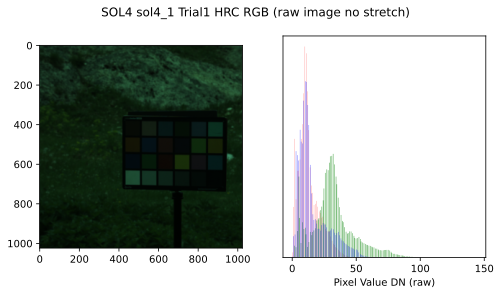

(<Figure size 800x400 with 2 Axes>,
 array([<Axes: >, <Axes: xlabel='Pixel Value DN (raw)'>], dtype=object))

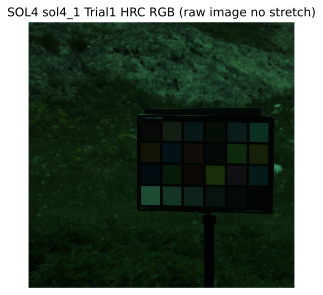

In [14]:
hrc_rgb.show_image('raw')

Here's what the target should look like...

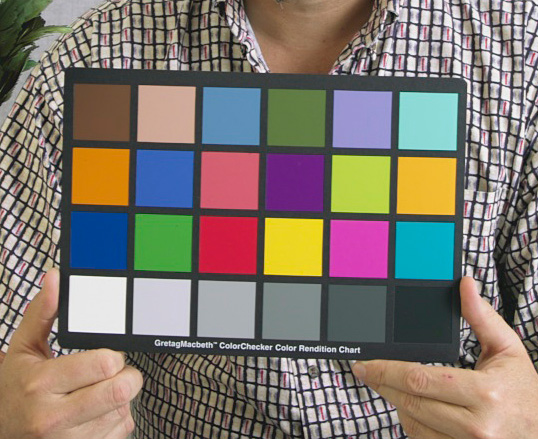

In [15]:
from IPython.display import Image, display

# Display the Gretag-MacBeth ColorChecker image
image_path = "Gretag-MacBeth_ColorChecker.jpg"  # Update the path if necessary
display(Image(filename=image_path))

Here's what it looks like with brightest pixel equalisation:

Stretching image using brightest pixel stretch


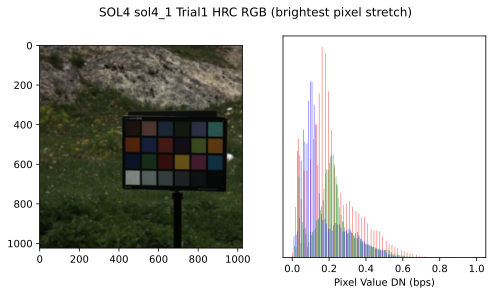

(<Figure size 800x400 with 2 Axes>,
 array([<Axes: >, <Axes: xlabel='Pixel Value DN (bps)'>], dtype=object))

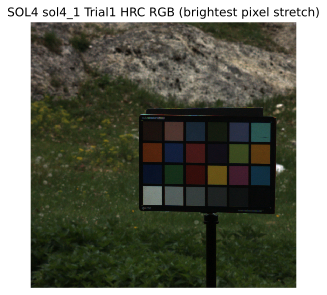

In [16]:
hrc_rgb.show_image('bps')

and 99th percentile equalisation

Stretching image using 99th percentile stretch


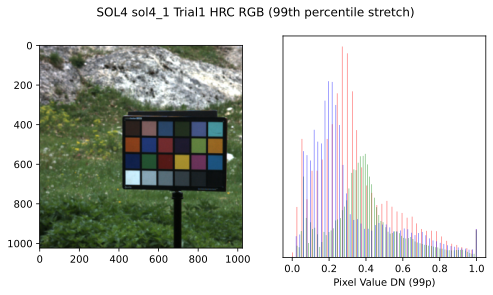

(<Figure size 800x400 with 2 Axes>,
 array([<Axes: >, <Axes: xlabel='Pixel Value DN (99p)'>], dtype=object))

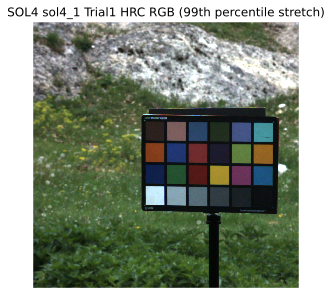

In [17]:
hrc_rgb.show_image('99p')

In [18]:
hrc_rgb.export_image('bps')
hrc_rgb.export_image('99p')

Exporting image using brightest pixel stretch
Stretching image using brightest pixel stretch
Exporting image using 99th percentile stretch
Stretching image using 99th percentile stretch


PosixPath('../../data/../processed/SOL4/sol4_1/Trial1/HRC/RGB/SOL4_sol4_1_Trial1_HRC_RGB_99p.png')

# Applying Calibration Target Colour Correction to HRC

Now we will extract the patch values from the HRC raw image, and find the colour correction matrix that achieves the reference sRGB values.

In [22]:
cal_targ = aupy.CalibrationTarget()

/opt/homebrew/Caskroom/miniconda/base/envs/aupy_dev/lib/python3.13/site-packages/IPython/extensions/deduperreload/deduperreload.py:290: DeprecationWarning: ast.Ellipsis is deprecated and will be removed in Python 3.14; use ast.Constant instead
  elif not isinstance(ast_elt, (ast.Ellipsis, ast.Pass)):
/opt/homebrew/Caskroom/miniconda/base/envs/aupy_dev/lib/python3.13/site-packages/IPython/extensions/deduperreload/deduperreload.py:290: DeprecationWarning: ast.Ellipsis is deprecated and will be removed in Python 3.14; use ast.Constant instead
  elif not isinstance(ast_elt, (ast.Ellipsis, ast.Pass)):
/opt/homebrew/Caskroom/miniconda/base/envs/aupy_dev/lib/python3.13/site-packages/IPython/extensions/deduperreload/deduperreload.py:290: DeprecationWarning: ast.Ellipsis is deprecated and will be removed in Python 3.14; use ast.Constant instead
  elif not isinstance(ast_elt, (ast.Ellipsis, ast.Pass)):
/opt/homebrew/Caskroom/miniconda/base/envs/aupy_dev/lib/python3.13/site-packages/IPython/exten

/opt/homebrew/Caskroom/miniconda/base/envs/aupy_dev/lib/python3.13/site-packages/IPython/extensions/deduperreload/deduperreload.py:290: DeprecationWarning: ast.Ellipsis is deprecated and will be removed in Python 3.14; use ast.Constant instead
  elif not isinstance(ast_elt, (ast.Ellipsis, ast.Pass)):
/opt/homebrew/Caskroom/miniconda/base/envs/aupy_dev/lib/python3.13/site-packages/IPython/extensions/deduperreload/deduperreload.py:290: DeprecationWarning: ast.Ellipsis is deprecated and will be removed in Python 3.14; use ast.Constant instead
  elif not isinstance(ast_elt, (ast.Ellipsis, ast.Pass)):
/opt/homebrew/Caskroom/miniconda/base/envs/aupy_dev/lib/python3.13/site-packages/IPython/extensions/deduperreload/deduperreload.py:290: DeprecationWarning: ast.Ellipsis is deprecated and will be removed in Python 3.14; use ast.Constant instead
  elif not isinstance(ast_elt, (ast.Ellipsis, ast.Pass)):
/opt/homebrew/Caskroom/miniconda/base/envs/aupy_dev/lib/python3.13/site-packages/IPython/exten

Stretching image using 99th percentile stretch
Searching for colour checker...


/Users/sci/.local/lib/python3.13/site-packages/colour/utilities/verbose.py:322: ColourUsageWarning: "OpenImageIO" related API features are not available, switching to "Imageio"!
  warn(*args, **kwargs)  # noqa: B028



0: 1280x1280 1 ColorCheckerClassic24, 3393.0ms
Speed: 14.9ms preprocess, 3393.0ms inference, 5.2ms postprocess per image at shape (1, 3, 1280, 1280)


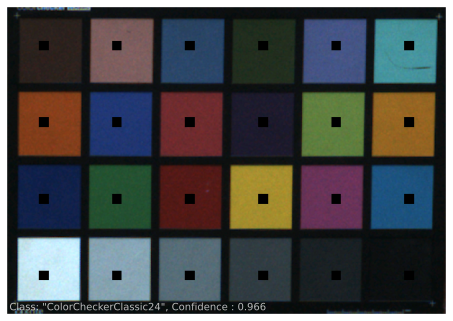

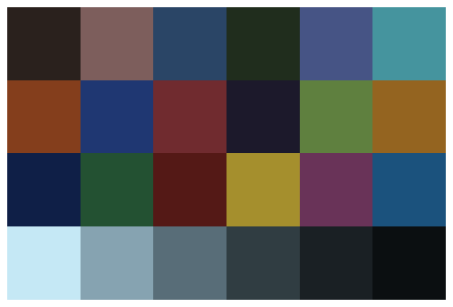

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


Found 1 colour checkers


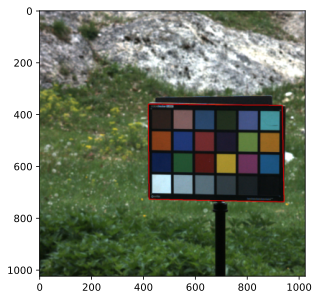

Width: 516 Height: 367


/Users/sci/.local/lib/python3.13/site-packages/colour/utilities/verbose.py:322: ColourUsageWarning: Cannot compute the colour checker orientation because the reference values are not available! Please update "Colour" to a version greater-than 0.4.4.
  warn(*args, **kwargs)  # noqa: B028


array([[ 0.04385185, -0.00449406, -0.00129422],
       [-0.00545308,  0.01685853, -0.00465622],
       [-0.00069132, -0.00384515,  0.02251842]])

In [25]:
cal_targ.find_target_and_compute_ccm(hrc_rgb, show=True)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0752852569339..1.97480329084].


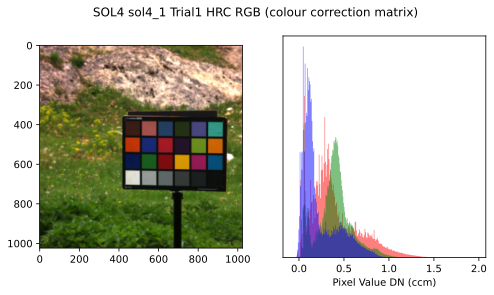

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0752852569339..1.97480329084].


(<Figure size 800x400 with 2 Axes>,
 array([<Axes: >, <Axes: xlabel='Pixel Value DN (ccm)'>], dtype=object))

In [26]:
hrc_rgb.show_image('ccm')

Now let's export this CCM, and see if we can apply to a range of other HRC scenes and get good results.

In [27]:
hrc_rgb.export_ccm()

CCM saved to ../data/ccms/HRC/ccm.csv


First, let's look at other HRC images from Sol 4

In [42]:
test_sol = 'SOL4'
test_scene = 'sol4_4'
test_trial = 'Trial2'

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.030847046539..2.19306195306].


CCM loaded from ../data/ccms/HRC/ccm.csv


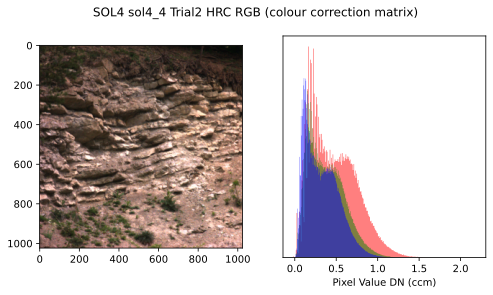

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.030847046539..2.19306195306].


(<Figure size 800x400 with 2 Axes>,
 array([<Axes: >, <Axes: xlabel='Pixel Value DN (ccm)'>], dtype=object))

In [43]:
hrc_rgb_test_loader = aupy.AupeIO(camera, frame, test_sol, test_scene, test_trial)
hrc_rgb_test = hrc_rgb_test_loader.load_frame()
hrc_rgb_test.debayer()
hrc_rgb_test.load_ccm(hrc_rgb_test.camera, sol, scene, trial)
hrc_rgb_test.show_image('ccm')

## Loading a WAC RGB Image

In [51]:
camera = 'LWAC'
frame = 'RGB'

In [52]:
lwac_rgb_loader = aupy.AupeIO(camera, frame, sol, scene)

In [53]:
lwac_rgb = lwac_rgb_loader.load_frame()

In [54]:
lwac_rgb.exposure_correct()

Stretching image using raw image no stretch


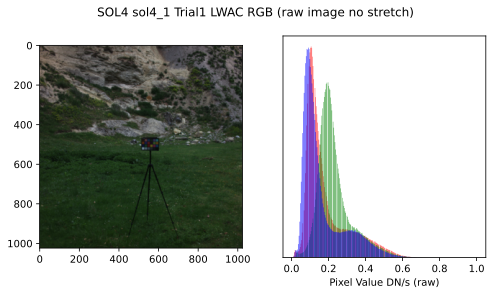

(<Figure size 800x400 with 2 Axes>,
 array([<Axes: >, <Axes: xlabel='Pixel Value DN/s (raw)'>], dtype=object))

In [55]:
lwac_rgb.show_image()

We can export these RGB images, again specifying which stretch to use during export.

In [56]:
lwac_rgb.export_image('raw')
lwac_rgb.export_image('bps')
lwac_rgb.export_image('99p')

Exporting image using raw image no stretch
Exporting image using brightest pixel stretch
Stretching image using brightest pixel stretch
Exporting image using 99th percentile stretch
Stretching image using 99th percentile stretch


PosixPath('../../data/../processed/SOL4/sol4_1/Trial1/LWAC/RGB/SOL4_sol4_1_Trial1_LWAC_RGB_99p.png')

Now let's look at the Right WAC:

In [57]:
camera = 'RWAC'
frame = 'RGB'

In [58]:
rwac_rgb_loader = aupy.AupeIO(camera, frame, sol, scene)

In [59]:
rwac_rgb = rwac_rgb_loader.load_frame()

Stretching image using 99th percentile stretch


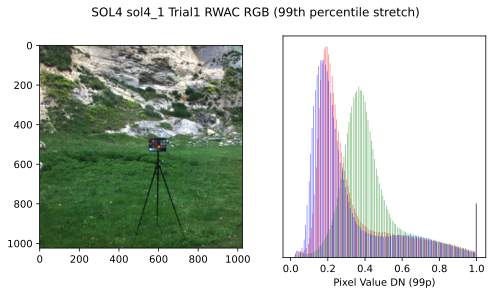

(<Figure size 800x400 with 2 Axes>,
 array([<Axes: >, <Axes: xlabel='Pixel Value DN (99p)'>], dtype=object))

In [60]:
rwac_rgb.show_image('99p')

In [61]:
rwac_rgb.exposure_correct()

Stretching image using 99th percentile stretch


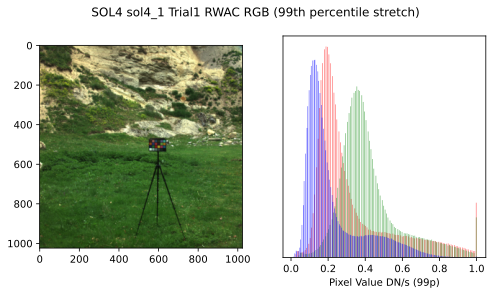

(<Figure size 800x400 with 2 Axes>,
 array([<Axes: >, <Axes: xlabel='Pixel Value DN/s (99p)'>], dtype=object))

In [65]:
rwac_rgb.show_image('99p')

In [66]:
rwac_rgb.export_image('raw')
rwac_rgb.export_image('bps')
rwac_rgb.export_image('99p')

Exporting image using raw image no stretch
Exporting image using brightest pixel stretch
Stretching image using brightest pixel stretch
Exporting image using 99th percentile stretch
Stretching image using 99th percentile stretch


PosixPath('../../data/../processed/SOL4/sol4_1/Trial1/RWAC/RGB/SOL4_sol4_1_Trial1_RWAC_RGB_99p.png')

That covers the first pass of colour processing. Now we need to apply this to HRC, including debayering. Then, we can go back to more processing including the correction by colour checker sRGB value.

In [ ]:
camera = 'HRC'
frame = 'RGB'

# Developing Proper Colour Correction

We're now in a position where we can in principal draw each patch on the calibration target, and then it follows that we can load in the calibration target patch reference data, and find the colour correction matrix that best colour balances the scene.

Steps:
1. Open the colour target image
2. Load up the calibration target into a new calibration target object
3. draw the calibration target patches
4. get the value for each scene target patch
5. formulate the colour correction matrix problem
6. solve the colour correction matrix
7. apply the colour correction matrix

In [ ]:
cal_targ = aupy.CalibrationTarget()

In [ ]:
hrc_example_img = hrc_rgb.get_image('99p')

We use the detect_colour_checker_inference function to find the colour checker in the image.

In [ ]:
result = cal_targ.find_in_scene(hrc_example_img)

We use the part of the function that finds the quadrilateral that encloses the colour checker.

In [ ]:
cal_targ.show_target_outline(hrc_example_img)

For HRC, we want to find the colour correction matrix that converts from the unbalanced debayered image to the sRGB space, so that our colour correction is independent of the scene content.

So now we want to get out the patch values of the unbalanced HRC image.

In [ ]:
unbalanced_hrc = hrc_rgb.get_image()

In [ ]:
patch_data = cal_targ.get_observed_vals(unbalanced_hrc)

Now we have the swatch colour from the uncorrected image.

In [ ]:
obs_ct_vals = patch_data

In [ ]:
ref_ct_sRGB_vals = cal_targ.load_reference_vals('sRGB')

Now we can solve for the colour correction matrix, by finding the matrix that maps from the patch_data.swatch_colours to the reference XYZ data.

In [ ]:
import colour

In [ ]:
# find the matrix that maps the observed values to the reference values
ccm = colour.matrix_colour_correction(obs_ct_vals, ref_ct_sRGB_vals)

In [ ]:
ccm_hrc = colour.apply_matrix_colour_correction(unbalanced_hrc, ccm)

In [ ]:
plt.imshow(ccm_hrc)

Collecting these pieces together:

In [ ]:
hrc_example_img = hrc_rgb.get_image('99p') # get approx colour by stretch
result = cal_targ.find_in_scene(hrc_example_img) # find the target in the image
cal_targ.show_target_outline(hrc_example_img) # show results of target detection
unbalanced_hrc = hrc_rgb.get_image() # get the unbalanced image
obs_ct_dRGB_vals = cal_targ.get_observed_vals(unbalanced_hrc) # measure the patches in the unbalanced image
ref_ct_sRGB_vals = cal_targ.load_reference_vals('sRGB') # load the reference values
# find the matrix that maps the observed values to the reference values
ccm = colour.matrix_colour_correction(obs_ct_vals, ref_ct_sRGB_vals)
# apply the CCM to the unbalanced image
hrc_rgb_srgb = colour.apply_matrix_colour_correction(unbalanced_hrc, ccm)

In [ ]:
cal_targ.find_target_and_compute_ccm(hrc_rgb, show=True)

In [ ]:
hrc_rgb.show_image('ccm')

In [ ]:
hrc_rgb.export_image('ccm')

Now we'd like to save this ccm matrix, and apply it to another HRC scene, and see what the outcome is.

In [ ]:
hrc_rgb.export_ccm()

Now lets load and HRC image from a different scene, and see if we cna load in this ccm, and apply it.

In [ ]:
sol = 'SOL4' # set this manually
scene = 'sol4_0' # set this manually
trial = 'Trial1' 

In [ ]:
hrc_test_rgb_loader = aupy.AupeIO('HRC', 'RGB', sol, scene, trial)

In [ ]:
hrc_test_rgb = hrc_test_rgb_loader.load_frame()
hrc_test_rgb.debayer()

In [ ]:
hrc_test_rgb.show_image('99p')

In [ ]:
hrc_test_rgb.load_ccm(hrc_test_rgb.camera, hrc_rgb.sol, hrc_rgb.scene, hrc_rgb.trial)

In [ ]:
hrc_test_rgb.show_image('ccm')

In [ ]:
hrc_test_rgb.export_image('ccm')

Ok that has worked quite well, so now I just need to get it working for the WACs, and then I should be able to apply batch processing across all images. I just need to set up and auot ccm file finder.

---
# Apply the Auto Colour Correction to WAC images

In [ ]:
# lwac_rgb.exposure_correct()

Stretching image using 99th percentile stretch


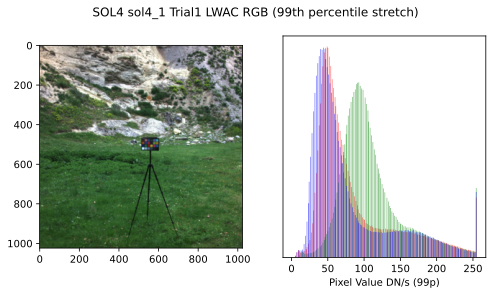

(<Figure size 800x400 with 2 Axes>,
 array([<Axes: >, <Axes: xlabel='Pixel Value DN/s (99p)'>], dtype=object))

In [79]:
lwac_rgb.show_image('99p')

In [80]:
cal_targ = aupy.CalibrationTarget()

/opt/homebrew/Caskroom/miniconda/base/envs/aupy_dev/lib/python3.13/site-packages/IPython/extensions/deduperreload/deduperreload.py:290: DeprecationWarning: ast.Ellipsis is deprecated and will be removed in Python 3.14; use ast.Constant instead
  elif not isinstance(ast_elt, (ast.Ellipsis, ast.Pass)):
/opt/homebrew/Caskroom/miniconda/base/envs/aupy_dev/lib/python3.13/site-packages/IPython/extensions/deduperreload/deduperreload.py:290: DeprecationWarning: ast.Ellipsis is deprecated and will be removed in Python 3.14; use ast.Constant instead
  elif not isinstance(ast_elt, (ast.Ellipsis, ast.Pass)):
/opt/homebrew/Caskroom/miniconda/base/envs/aupy_dev/lib/python3.13/site-packages/IPython/extensions/deduperreload/deduperreload.py:290: DeprecationWarning: ast.Ellipsis is deprecated and will be removed in Python 3.14; use ast.Constant instead
  elif not isinstance(ast_elt, (ast.Ellipsis, ast.Pass)):
/opt/homebrew/Caskroom/miniconda/base/envs/aupy_dev/lib/python3.13/site-packages/IPython/exten

Stretching image using 99th percentile stretch
Searching for colour checker...


/Users/sci/.local/lib/python3.13/site-packages/colour/utilities/verbose.py:322: ColourUsageWarning: "OpenImageIO" related API features are not available, switching to "Imageio"!
  warn(*args, **kwargs)  # noqa: B028



0: 1280x1280 (no detections), 2753.7ms
Speed: 10.3ms preprocess, 2753.7ms inference, 1.1ms postprocess per image at shape (1, 3, 1280, 1280)
No colour checker found
Searching for colour checker in cropped image...


/Users/sci/.local/lib/python3.13/site-packages/colour/utilities/verbose.py:322: ColourUsageWarning: "OpenImageIO" related API features are not available, switching to "Imageio"!
  warn(*args, **kwargs)  # noqa: B028



0: 1280x1280 1 ColorCheckerClassic24, 2362.9ms
Speed: 8.6ms preprocess, 2362.9ms inference, 3.5ms postprocess per image at shape (1, 3, 1280, 1280)


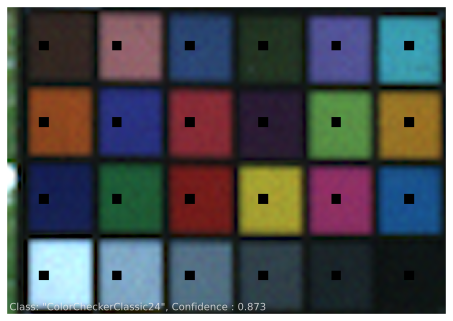

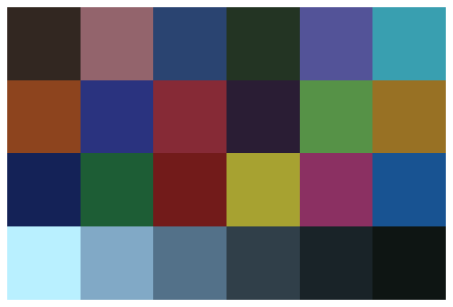

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


Found 1 colour checkers


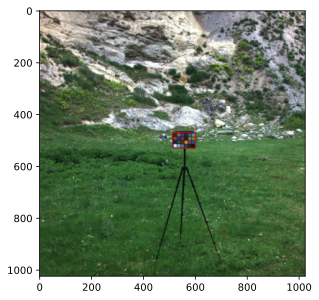

Stretching image using raw image no stretch
Width: 89 Height: 59


/Users/sci/.local/lib/python3.13/site-packages/colour/utilities/verbose.py:322: ColourUsageWarning: Cannot compute the colour checker orientation because the reference values are not available! Please update "Colour" to a version greater-than 0.4.4.
  warn(*args, **kwargs)  # noqa: B028


array([[ 0.01013382,  0.00169907, -0.00268721],
       [-0.00120501,  0.00929559, -0.00098876],
       [-0.00015843, -0.0023176 ,  0.00835492]])

In [83]:
cal_targ.find_target_and_compute_ccm(lwac_rgb, show=True)

In [84]:
import numpy as np

/opt/homebrew/Caskroom/miniconda/base/envs/aupy_dev/lib/python3.13/site-packages/IPython/extensions/deduperreload/deduperreload.py:290: DeprecationWarning: ast.Ellipsis is deprecated and will be removed in Python 3.14; use ast.Constant instead
  elif not isinstance(ast_elt, (ast.Ellipsis, ast.Pass)):
/opt/homebrew/Caskroom/miniconda/base/envs/aupy_dev/lib/python3.13/site-packages/IPython/extensions/deduperreload/deduperreload.py:290: DeprecationWarning: ast.Ellipsis is deprecated and will be removed in Python 3.14; use ast.Constant instead
  elif not isinstance(ast_elt, (ast.Ellipsis, ast.Pass)):
/opt/homebrew/Caskroom/miniconda/base/envs/aupy_dev/lib/python3.13/site-packages/IPython/extensions/deduperreload/deduperreload.py:290: DeprecationWarning: ast.Ellipsis is deprecated and will be removed in Python 3.14; use ast.Constant instead
  elif not isinstance(ast_elt, (ast.Ellipsis, ast.Pass)):
/opt/homebrew/Caskroom/miniconda/base/envs/aupy_dev/lib/python3.13/site-packages/IPython/exten

Stretching image using raw image no stretch


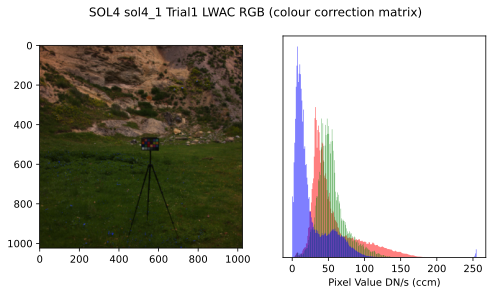

(<Figure size 800x400 with 2 Axes>,
 array([<Axes: >, <Axes: xlabel='Pixel Value DN/s (ccm)'>], dtype=object))

In [86]:
lwac_rgb.show_image('ccm')

Now let's try and apply the same CCM to another WAC RGB scene

In [93]:
lwac_rgb.export_ccm()

CCM saved to ../data/ccms/LWAC/ccm.csv


In [ ]:
lwac_rgb_test_loader = aupy.AupeIO('LWAC', 'RGB', sol, scene, trial)
lwac_test_rgb = lwac_rgb_test_loader.load_frame()
lwac_test_rgb.exposure_correct()

In [ ]:
lwac_test_rgb.show_image('99p')

In [ ]:
lwac_test_rgb.load_ccm(lwac_test_rgb.camera, lwac_rgb.sol, lwac_rgb.scene, lwac_rgb.trial)

In [ ]:
lwac_rgb.load_ccm(lwac_rgb.camera, lwac_rgb.sol, lwac_rgb.scene, lwac_rgb.trial)

In [ ]:
lwac_rgb.show_image('ccm')

In [ ]:
lwac_test_rgb.show_image('ccm')

In [ ]:
lwac_test_rgb.export_image('ccm')

Now lets get a matrix for the rwac

In [ ]:
# rwac_rgb.exposure_correct()

In [87]:
rwac_rgb.get_image('bps', dtype=np.uint16)  

Stretching image using brightest pixel stretch


array([[[14521, 12542,  8755],
        [14894, 13483,  9286],
        [14521, 11915,  9286],
        ..., 
        [ 8191, 13483,  9816],
        [ 8564, 14423,  8490],
        [ 9681, 15364,  8225]],

       [[14149, 12542,  7694],
        [14894, 12229,  7694],
        [16756, 12856,  9286],
        ..., 
        [ 8564, 13483,  9021],
        [ 7819, 14423,  8225],
        [ 8564, 14110,  9551]],

       [[11170, 10347,  6367],
        [11915,  9093,  6898],
        [12660,  9720,  7694],
        ..., 
        [ 8191, 12856,  9551],
        [ 8564, 13169, 10612],
        [ 8191, 12856, 11143]],

       ..., 
       [[ 8191, 12229,  3979],
        [ 8564, 12229,  4245],
        [ 8564, 12229,  3714],
        ..., 
        [10053, 13169,  6898],
        [10426, 14110,  5041],
        [10798, 14423,  5306]],

       [[ 7074, 10661,  4245],
        [ 8191, 12229,  3449],
        [ 7447, 10974,  3979],
        ..., 
        [10053, 13169,  6102],
        [10053, 13796,  6367],
        [1

Stretching image using 99th percentile stretch


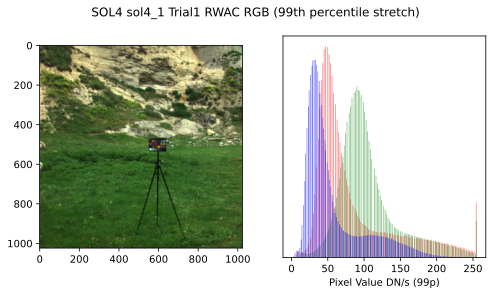

(<Figure size 800x400 with 2 Axes>,
 array([<Axes: >, <Axes: xlabel='Pixel Value DN/s (99p)'>], dtype=object))

In [88]:
rwac_rgb.show_image('99p')

In [89]:
cal_targ = aupy.CalibrationTarget()

In [97]:
cal_targ.find_target_and_compute_ccm(rwac_rgb, show=True)

/opt/homebrew/Caskroom/miniconda/base/envs/aupy_dev/lib/python3.13/site-packages/IPython/extensions/deduperreload/deduperreload.py:290: DeprecationWarning: ast.Ellipsis is deprecated and will be removed in Python 3.14; use ast.Constant instead
  elif not isinstance(ast_elt, (ast.Ellipsis, ast.Pass)):
/opt/homebrew/Caskroom/miniconda/base/envs/aupy_dev/lib/python3.13/site-packages/IPython/extensions/deduperreload/deduperreload.py:290: DeprecationWarning: ast.Ellipsis is deprecated and will be removed in Python 3.14; use ast.Constant instead
  elif not isinstance(ast_elt, (ast.Ellipsis, ast.Pass)):
/opt/homebrew/Caskroom/miniconda/base/envs/aupy_dev/lib/python3.13/site-packages/IPython/extensions/deduperreload/deduperreload.py:290: DeprecationWarning: ast.Ellipsis is deprecated and will be removed in Python 3.14; use ast.Constant instead
  elif not isinstance(ast_elt, (ast.Ellipsis, ast.Pass)):
/opt/homebrew/Caskroom/miniconda/base/envs/aupy_dev/lib/python3.13/site-packages/IPython/exten

Stretching image using 99th percentile stretch
Searching for colour checker...


/Users/sci/.local/lib/python3.13/site-packages/colour/utilities/verbose.py:322: ColourUsageWarning: "OpenImageIO" related API features are not available, switching to "Imageio"!
  warn(*args, **kwargs)  # noqa: B028



0: 1280x1280 (no detections), 2676.3ms
Speed: 9.8ms preprocess, 2676.3ms inference, 0.8ms postprocess per image at shape (1, 3, 1280, 1280)
No colour checker found
Searching for colour checker in cropped image...


/Users/sci/.local/lib/python3.13/site-packages/colour/utilities/verbose.py:322: ColourUsageWarning: "OpenImageIO" related API features are not available, switching to "Imageio"!
  warn(*args, **kwargs)  # noqa: B028



0: 1280x1280 1 ColorCheckerClassic24, 2361.5ms
Speed: 8.4ms preprocess, 2361.5ms inference, 3.6ms postprocess per image at shape (1, 3, 1280, 1280)
Result confidence: 0.8088405728340149 < 0.85
Manually draw out the calibration target quadrilateral
Select a ROI and then press SPACE or ENTER button!
Cancel the selection process by pressing c button!
No ROI selected
No calibration target found
No calibration target found


False

/opt/homebrew/Caskroom/miniconda/base/envs/aupy_dev/lib/python3.13/site-packages/IPython/extensions/deduperreload/deduperreload.py:290: DeprecationWarning: ast.Ellipsis is deprecated and will be removed in Python 3.14; use ast.Constant instead
  elif not isinstance(ast_elt, (ast.Ellipsis, ast.Pass)):
/opt/homebrew/Caskroom/miniconda/base/envs/aupy_dev/lib/python3.13/site-packages/IPython/extensions/deduperreload/deduperreload.py:290: DeprecationWarning: ast.Ellipsis is deprecated and will be removed in Python 3.14; use ast.Constant instead
  elif not isinstance(ast_elt, (ast.Ellipsis, ast.Pass)):
/opt/homebrew/Caskroom/miniconda/base/envs/aupy_dev/lib/python3.13/site-packages/IPython/extensions/deduperreload/deduperreload.py:290: DeprecationWarning: ast.Ellipsis is deprecated and will be removed in Python 3.14; use ast.Constant instead
  elif not isinstance(ast_elt, (ast.Ellipsis, ast.Pass)):
/opt/homebrew/Caskroom/miniconda/base/envs/aupy_dev/lib/python3.13/site-packages/IPython/exten

Stretching image using raw image no stretch


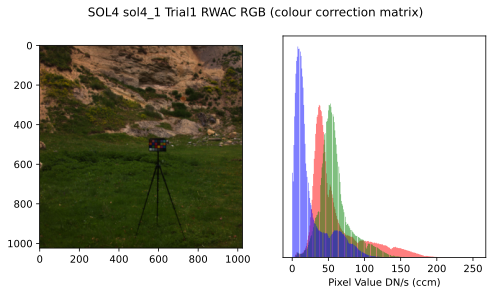

(<Figure size 800x400 with 2 Axes>,
 array([<Axes: >, <Axes: xlabel='Pixel Value DN/s (ccm)'>], dtype=object))

In [96]:
rwac_rgb.show_image('ccm')

Now let's try and apply the same CCM to another WAC RGB scene

In [95]:
rwac_rgb.export_ccm()

CCM saved to ../data/ccms/RWAC/ccm.csv


# Experimenting with auto-calibration target detection

We install the auto detection software via pip with:

```pip install --user colour-checker-detection```

we also need the dependencies:

```pip install click```

```pip install ultralytics```

```pip install --user colour-science```



We follow the example notebook (/examples_detection_inference.ipynb) instructions for setting up the colour_checker_detection software.

In [ ]:
import colour

from colour_checker_detection import (
    ROOT_RESOURCES_EXAMPLES,
    detect_colour_checkers_inference)

colour.plotting.colour_style()

colour.utilities.describe_environment();

Lets use our HRC image with the target in as our image to work with.

In [ ]:
import glob
import numpy as np
import os

In [ ]:
hrc_example_path = Path('../../processed/SOL4/sol4_1/Trial1/HRC/SOL4_sol4_1_Trial1_HRC_RGB_99p.png')
hrc_example_img = hrc_rgb.get_image('99p')


The colour science library likes to work with cctf decoded images, so we perform this on our test image.

In [ ]:
test_img = colour.cctf_decoding(hrc_example_img)

In [ ]:
# run the colour checker detection algorithm
colour_checker_data = detect_colour_checkers_inference(test_img, additional_data=True, show=True)

We can see that the colourchecker has been found, and boxes have been drawn on each patch.

 Let's find the properties of the detected colour checker:

In [ ]:
vars(colour_checker_data[0]).keys()

We have the colours of the swatches:

In [ ]:
colour_checker_data[0].swatch_colours

How many patches?

In [ ]:
colour_checker_data[0].swatch_colours.shape[0]

The colours are given in normalised units: 0 - 1.

We have the locations of the swatches:

In [ ]:
colour_checker_data[0].swatch_masks

The coordinates for the masks appear to be of the form: (x0 - x1, y0 - y1).

The 'colour_checker' attribute appears to be the image of the colour checker:

In [ ]:
colour_checker_data[0].colour_checker

In [ ]:
plt.imshow(colour.cctf_encoding(colour_checker_data[0].colour_checker), vmin=0, vmax=1)

Indeed, this is where the information is extracted from.

We note that the patch colours are very dark in this visualisation.

The quadrilateral keyword gives the coordinates of the corners of the colour checker in the original image.

In [ ]:
colour_checker_data[0].quadrilateral

We can test this by drawing a polygon ROI on the original image, using these coordinates.

In [ ]:
import cv2

In [ ]:
# use cv2 polyroi to draw the quadtrilateral on the image
def draw_quadrilateral(image, quadrilateral):
    # Convert the quadrilateral points to integer
    points = np.int32(quadrilateral)

    # Draw the quadrilateral on the image
    quad_img = cv2.polylines(image, [points], isClosed=True, color=(255, 0, 0), thickness=2)

    disp = plt.imshow(quad_img)

    return disp

In [ ]:
draw_quadrilateral(hrc_example_img, colour_checker_data[0].quadrilateral)

Indeed, the quadrilateral draws around the colourchecker.

Note that it appears that the patch masks are drawn relative to the extracted calibration target image, rather than in the original image space.

Let's try to draw the patch masks on the calibration target.

In [ ]:
colour_checker_data[0].swatch_masks.shape[0]

In [ ]:
ct_img = colour_checker_data[0].colour_checker.copy()
ct_img.shape

ct_img = cv2.rectangle(ct_img, (1200, 800), (1250, 850), (255, 0, 0), 2)
plt.imshow(colour.cctf_encoding(ct_img))

In [ ]:
ct_img = colour_checker_data[0].colour_checker.copy()

masks = colour_checker_data[0].swatch_masks.tolist()

for m, mask in enumerate(masks):
    print(m, mask)
    # note on mapping mask coordinates to image coordinates
    # rectangle coords: (x0, y0), (x1, y1), where (x0, y0) is top left corner, 
    # (x1, y1) is bottom right corner, and the origin is the top left corner of the image.
    # these positioned in the mask coords as: [y0, y1, x0, x1]
    ct_img = cv2.rectangle(ct_img, (mask[2], mask[0]), (mask[3], mask[1]), (255, 0, 0), 2)
plt.imshow(colour.cctf_encoding(ct_img))

Ok, we now have drawn out the ROI's of each patch. Now lets extract the values of each patch, and compare to those extracted by the algorithm

In [ ]:
ct_img = colour_checker_data[0].colour_checker.copy()
ct_img_annotated = (ct_img.copy()*255).astype(np.uint8)

masks = colour_checker_data[0].swatch_masks.tolist()

patch_vals = []

for m, mask in enumerate(masks):
    # print(m, mask)
    # note on mapping mask coordinates to image coordinates
    # rectangle coords: (x0, y0), (x1, y1), where (x0, y0) is top left corner, 
    # (x1, y1) is bottom right corner, and the origin is the top left corner of the image.
    # these positioned in the mask coords as: [y0, y1, x0, x1]
    patch_val = np.mean(ct_img[mask[0]:mask[1], mask[2]:mask[3], :], axis=(0, 1))
    patch_vals.append(patch_val)
    col = (int(patch_val[0]*255),int(patch_val[1]*255),int(patch_val[2]*255)) # format it for annotation
    ct_img_annotated = cv2.rectangle(ct_img_annotated, (mask[2], mask[0]), (mask[3], mask[1]), col, -1)
    ct_img_annotated = cv2.rectangle(ct_img_annotated, (mask[2], mask[0]), (mask[3], mask[1]), (255,0,0), 2)
print(f'Patch numbers: {len(patch_vals)}')
plt.imshow(colour.cctf_encoding(ct_img_annotated/255))

In the above image we've shaded in the patch ROIs with the mean colour measured, and bounded the ROI in Red. This confirms that we are measuring the correct colour at each patch.

Editing the ROI size

For our algorithm, we'd like to extract larger patch sizes - so let's see what parameters we have available for expanding the ROI sizes.

In [ ]:
# run the colour checker detection algorithm again
colour_checker_data = detect_colour_checkers_inference(hrc_example_img, additional_data=True, show=True, samples=100)

In [ ]:
ct_img = colour_checker_data[0].colour_checker.copy()

masks = colour_checker_data[0].swatch_masks.tolist()

for m, mask in enumerate(masks):
    # note on mapping mask coordinates to image coordinates
    # rectangle coords: (x0, y0), (x1, y1), where (x0, y0) is top left corner, 
    # (x1, y1) is bottom right corner, and the origin is the top left corner of the image.
    # these positioned in the mask coords as: [y0, y1, x0, x1]
    ct_img = cv2.rectangle(ct_img, (mask[2], mask[0]), (mask[3], mask[1]), (255, 0, 0), 2)
plt.imshow(colour.cctf_encoding(ct_img))

RWAC example

In the WAC images, the target is often smaller, and we find it doesn't always find the target.

In [ ]:
rwac_rgb_exmpl_path = '../../processed/SOL4/sol4_1/Trial1/WAC_RGB/SOL4_sol4_1_Trial1_RWAC_RGB_99p.png'
rwac_rgb_exmpl = rwac_rgb.get_image('99p')

In [ ]:
# # select the central 50% of the image
# rwac_rgb_exmpl = rwac_rgb_exmpl[rwac_rgb_exmpl.shape[0]//4:rwac_rgb_exmpl.shape[0]//4 + rwac_rgb_exmpl.shape[0]//2, rwac_rgb_exmpl.shape[1]//4:rwac_rgb_exmpl.shape[1]//4+rwac_rgb_exmpl.shape[1]//2]
# rwac_rgb_exmpl.shape

Lets say we want a minimum patch size allowed of 5 x 5 pixels.

That's 5*5 = 25 pixels total in the image.

For a 1024 * 1024 image, with 24 patches, the scale factor is:

((1024*1024)/24)/(5*5) = f

In [ ]:
f = ((1024*1024)/24)/(5*5)

In [ ]:
f

In [ ]:
((1024*1024)/24)/f

In [ ]:
COLOUR_CHECKER_IMAGE_PATHS = [rwac_rgb_exmpl_path]
COLOUR_CHECKER_IMAGES = [
    colour.cctf_decoding(rwac_rgb_exmpl)
]

image = COLOUR_CHECKER_IMAGES[0]
colour.plotting.plot_image(colour.cctf_encoding(image))


Let's try clipping by 100 pixels

In [ ]:
rwac_rgb_exmpl_path = '../../processed/SOL4/sol4_1/Trial1/WAC_RGB/SOL4_sol4_1_Trial1_RWAC_RGB_99p.png'
rwac_rgb_exmpl = rwac_rgb.get_image('99p')

# chop a border of X pixels from the image
x_pix = 100
rwac_rgb_exmpl = rwac_rgb_exmpl[x_pix:rwac_rgb_exmpl.shape[0]-x_pix, x_pix:rwac_rgb_exmpl.shape[1]-x_pix]
rwac_rgb_exmpl.shape

COLOUR_CHECKER_IMAGE_PATHS = [rwac_rgb_exmpl_path]
COLOUR_CHECKER_IMAGES = [
    colour.cctf_decoding(rwac_rgb_exmpl)
]

image = COLOUR_CHECKER_IMAGES[0]
colour.plotting.plot_image(colour.cctf_encoding(image))

In [ ]:
# run the colour checker detection algorithm again
colour_checker_data = detect_colour_checkers_inference(
                                        image, 
                                        additional_data=True, 
                                        samples=100,
                                        inferred_confidence=0.5,
                                        show=True)


In [ ]:
draw_quadrilateral(rwac_rgb_exmpl, colour_checker_data[0].quadrilateral)

In [ ]:
colour_checker_data

100 pix crop has failed. Interestingly, the algorithms has reported that it has found the ColorCheckerClassic24, but it has not populated the colour_checker_data with any information.

We take this as a fail.

Now let's run it with 200 pixel crop.

In [ ]:
rwac_rgb_exmpl_path = '../../processed/SOL4/sol4_1/Trial1/WAC_RGB/SOL4_sol4_1_Trial1_RWAC_RGB_99p.png'
rwac_rgb_exmpl = rwac_rgb.show_image('99p')

# chop a border of X pixels from the image
x_pix = 200
rwac_rgb_exmpl = rwac_rgb_exmpl[x_pix:rwac_rgb_exmpl.shape[0]-x_pix, x_pix:rwac_rgb_exmpl.shape[1]-x_pix]
rwac_rgb_exmpl.shape

COLOUR_CHECKER_IMAGE_PATHS = [rwac_rgb_exmpl_path]
COLOUR_CHECKER_IMAGES = [
    colour.cctf_decoding(rwac_rgb_exmpl)
]

image = COLOUR_CHECKER_IMAGES[0]
colour.plotting.plot_image(colour.cctf_encoding(image))

In [ ]:
# run the colour checker detection algorithm again
colour_checker_data = detect_colour_checkers_inference(
                                        image, 
                                        additional_data=True, 
                                        samples=100,
                                        show=True)


In [ ]:
colour_checker_data

Now the algorithm has succeeded!

So we can in principle run a search alogrithm that iteratively crops the image down, until the calibration target is large enough to be found by the algorithm.

It's frustrating that this isn't built into the software already. It should be as part of the swatch_minimum_area_factor parameter, but this hasn't been successful.

Now let's implement a simple function that uses cv2 to manually draw a box around the target, and then passes this to the autodetect algorithm.

In [ ]:
# image = rwac_rgb.rgb_image.copy()
image = rwac_rgb.apply_balance_vector('99p')

# # # # chop a border of X pixels from the image
# x_pix = 300
# image = image[x_pix:image.shape[0]-x_pix, x_pix:image.shape[1]-x_pix]
# print(image.shape)

image = colour.cctf_decoding(image)
# show the image
plt.imshow(colour.cctf_encoding(image))
plt.title('Full size image')
plt.show()

# first pass: run the colour checker detection algorithm
colour_checker_data = detect_colour_checkers_inference(
                                        image, 
                                        additional_data=True, 
                                        show=True)

if colour_checker_data == ():
    print('No colour checker detected')
    print('Manually select the colour checker region')
    # manually select the colour checker region
    ct_img = image.copy()
    ct_roi = cv2.selectROI('Select the centre of the colour checker region', colour.cctf_encoding(np.stack([ct_img[:,:,2],ct_img[:,:,1],ct_img[:,:,0]], axis=2)), fromCenter=True, showCrosshair=True)
    # force ROI to be a square of size 256 x 256
    roi_w = 256
    ct_roi = (ct_roi[0]-roi_w//2, ct_roi[1]-roi_w//2, roi_w, roi_w)
    cv2.destroyWindow('Select the colour checker region')
    ct_img = image[ct_roi[1]:ct_roi[1]+ct_roi[3], ct_roi[0]:ct_roi[0]+ct_roi[2]]

    # upsample the image to 1260 x 1260
    ct_img = cv2.resize(ct_img, (roi_w, roi_w), interpolation=cv2.INTER_CUBIC)

    # show the ct_img
    plt.imshow(colour.cctf_encoding(ct_img))
    plt.title('Colour checker region')
    plt.show()

    min_patch_size = 5
    f = (min_patch_size**2)/((roi_w**2)/24)

    colour_checker_data = detect_colour_checkers_inference(
                                        ct_img, 
                                        additional_data=True, 
                                        swatch_contour_scale=True,
                                        swatch_minimum_area_factor=f,
                                        show=True)


In [ ]:
colour_checker_data

In [ ]:
plt.imshow(ct_img)

In [ ]:
rwac_rgb_exmpl_path = '../../processed/SOL4/sol4_1/Trial1/WAC_RGB/SOL4_sol4_1_Trial1_RWAC_RGB_99p.png'
rwac_rgb_exmpl = rwac_rgb.rgb_image

# chop a border of X pixels from the image
x_pix = 200
rwac_rgb_exmpl = rwac_rgb_exmpl[x_pix:rwac_rgb_exmpl.shape[0]-x_pix, x_pix:rwac_rgb_exmpl.shape[1]-x_pix]
rwac_rgb_exmpl.shape

COLOUR_CHECKER_IMAGE_PATHS = [rwac_rgb_exmpl_path]
COLOUR_CHECKER_IMAGES = [
    colour.cctf_decoding(rwac_rgb_exmpl)
]

image = COLOUR_CHECKER_IMAGES[0]
colour.plotting.plot_image(colour.cctf_encoding(image))

---

# Segmentation Algorithm

Here we try the segmentation algorithm for colour checker detection.

---

In [ ]:
ct_img = colour_checker_data[0].colour_checker.copy()

masks = colour_checker_data[0].swatch_masks.tolist()

for m, mask in enumerate(masks):
    # note on mapping mask coordinates to image coordinates
    # rectangle coords: (x0, y0), (x1, y1), where (x0, y0) is top left corner, 
    # (x1, y1) is bottom right corner, and the origin is the top left corner of the image.
    # these positioned in the mask coords as: [y0, y1, x0, x1]
    ct_img = cv2.rectangle(ct_img, (mask[2], mask[0]), (mask[3], mask[1]), (255, 0, 0), 2)
plt.imshow(colour.cctf_encoding(ct_img))

Do the settings work on the HRC image?

In [ ]:
hrc_example_path = Path('../../processed/SOL4/sol4_1/Trial1/HRC/SOL4_sol4_1_Trial1_HRC_RGB_99p.png')
hrc_example_img = hrc_rgb.show_image('99p')

COLOUR_CHECKER_IMAGES = [
    colour.cctf_decoding(hrc_example_img)
]


image = COLOUR_CHECKER_IMAGES[0]
colour.plotting.plot_image(colour.cctf_encoding(image))

In [ ]:
# run the colour checker detection algorithm again
colour_checker_data = detect_colour_checkers_inference(image, additional_data=True, show=True, samples=32, swatch_minimum_area_factor=10000,apply_cctf_decoding=False)

In [ ]:
ct_img = colour_checker_data[0].colour_checker.copy()
ct_img_annotated = (ct_img.copy()*255).astype(np.uint8)

masks = colour_checker_data[0].swatch_masks.tolist()

patch_vals = []

for m, mask in enumerate(masks):
    # print(m, mask)
    # note on mapping mask coordinates to image coordinates
    # rectangle coords: (x0, y0), (x1, y1), where (x0, y0) is top left corner, 
    # (x1, y1) is bottom right corner, and the origin is the top left corner of the image.
    # these positioned in the mask coords as: [y0, y1, x0, x1]
    patch_val = np.mean(ct_img[mask[0]:mask[1], mask[2]:mask[3], :], axis=(0, 1))
    patch_vals.append(patch_val)
    col = (int(patch_val[0]*255),int(patch_val[1]*255),int(patch_val[2]*255)) # format it for annotation
    ct_img_annotated = cv2.rectangle(ct_img_annotated, (mask[2], mask[0]), (mask[3], mask[1]), col, -1)
    ct_img_annotated = cv2.rectangle(ct_img_annotated, (mask[2], mask[0]), (mask[3], mask[1]), (255,0,0), 2)
print(f'Patch numbers: {len(patch_vals)}')
plt.imshow(colour.cctf_encoding(ct_img_annotated/255))

In [ ]:

SWATCHES = []
for image in COLOUR_CHECKER_IMAGES:
    for colour_checker_data in detect_colour_checkers_inference(image, samples=100, additional_data=True):
        
        swatch_colours, swatch_masks, colour_checker_image, quadrilateral = (
            colour_checker_data.values)
        SWATCHES.append(swatch_colours)
        
        # Using the additional data to plot the colour checker and masks.
        masks_i = np.zeros(colour_checker_image.shape)
        for i, mask in enumerate(swatch_masks):
            masks_i[mask[0]:mask[1], mask[2]:mask[3], ...] = 1
        
        colour.plotting.plot_image(
            colour.cctf_encoding(
                np.clip(colour_checker_image + masks_i * 0.25, 0, 1)));


In [ ]:

SWATCHES
D65 = colour.CCS_ILLUMINANTS['CIE 1931 2 Degree Standard Observer']['C']
REFERENCE_COLOUR_CHECKER = colour.CCS_COLOURCHECKERS[
    'ColorChecker24 - After November 2014']

colour_checker_rows = REFERENCE_COLOUR_CHECKER.rows
colour_checker_columns = REFERENCE_COLOUR_CHECKER.columns

# NOTE: The reference swatches values as produced by the "colour.XYZ_to_RGB"
# definition are linear by default.
# See https://github.com/colour-science/colour-checker-detection/discussions/59
# for more information.
REFERENCE_SWATCHES = colour.XYZ_to_RGB(
        colour.xyY_to_XYZ(list(REFERENCE_COLOUR_CHECKER.data.values())),
        'sRGB', REFERENCE_COLOUR_CHECKER.illuminant)

for i, swatches in enumerate(SWATCHES):
    swatches_xyY = colour.XYZ_to_xyY(colour.RGB_to_XYZ(
        swatches, 'sRGB', D65))

    colour_checker = colour.characterisation.ColourChecker(
        os.path.basename(COLOUR_CHECKER_IMAGE_PATHS[i]),
        dict(zip(REFERENCE_COLOUR_CHECKER.data.keys(), swatches_xyY)),
        D65, colour_checker_rows, colour_checker_columns)
    
    colour.plotting.plot_multi_colour_checkers(
        [REFERENCE_COLOUR_CHECKER, colour_checker])
    
    swatches_f = colour.colour_correction(swatches, swatches, REFERENCE_SWATCHES)
    swatches_f_xyY = colour.XYZ_to_xyY(colour.RGB_to_XYZ(
        swatches_f, 'sRGB', D65))
    colour_checker = colour.characterisation.ColourChecker(
        '{0} - CC'.format(os.path.basename(COLOUR_CHECKER_IMAGE_PATHS[i])),
        dict(zip(REFERENCE_COLOUR_CHECKER.data.keys(), swatches_f_xyY)),
        D65, colour_checker_rows, colour_checker_columns)
    
    colour.plotting.plot_multi_colour_checkers(
        [REFERENCE_COLOUR_CHECKER, colour_checker])

    colour.plotting.plot_image(colour.cctf_encoding(
        colour.colour_correction(
            COLOUR_CHECKER_IMAGES[i], swatches, REFERENCE_SWATCHES)));

---

Applying the colour correction

In [ ]:
D65 = colour.CCS_ILLUMINANTS['CIE 1931 2 Degree Standard Observer']['C']
REFERENCE_COLOUR_CHECKER = colour.CCS_COLOURCHECKERS[
    'ColorChecker24 - After November 2014']

colour_checker_rows = REFERENCE_COLOUR_CHECKER.rows
colour_checker_columns = REFERENCE_COLOUR_CHECKER.columns

# NOTE: The reference swatches values as produced by the "colour.XYZ_to_RGB"
# definition are linear by default.
# See https://github.com/colour-science/colour-checker-detection/discussions/59
# for more information.
REFERENCE_SWATCHES = colour.XYZ_to_RGB(
        colour.xyY_to_XYZ(list(REFERENCE_COLOUR_CHECKER.data.values())),
        'sRGB', REFERENCE_COLOUR_CHECKER.illuminant)

for i, swatches in enumerate(SWATCHES):
    swatches_xyY = colour.XYZ_to_xyY(colour.RGB_to_XYZ(
        swatches, 'sRGB', D65))

    colour_checker = colour.characterisation.ColourChecker(
        os.path.basename(COLOUR_CHECKER_IMAGE_PATHS[i]),
        dict(zip(REFERENCE_COLOUR_CHECKER.data.keys(), swatches_xyY)),
        D65, colour_checker_rows, colour_checker_columns)
    
    colour.plotting.plot_multi_colour_checkers(
        [REFERENCE_COLOUR_CHECKER, colour_checker])
    
    swatches_f = colour.colour_correction(swatches, swatches, REFERENCE_SWATCHES)
    swatches_f_xyY = colour.XYZ_to_xyY(colour.RGB_to_XYZ(
        swatches_f, 'sRGB', D65))
    colour_checker = colour.characterisation.ColourChecker(
        '{0} - CC'.format(os.path.basename(COLOUR_CHECKER_IMAGE_PATHS[i])),
        dict(zip(REFERENCE_COLOUR_CHECKER.data.keys(), swatches_f_xyY)),
        D65, colour_checker_rows, colour_checker_columns)
    
    colour.plotting.plot_multi_colour_checkers(
        [REFERENCE_COLOUR_CHECKER, colour_checker])

    colour.plotting.plot_image(colour.cctf_encoding(
        colour.colour_correction(
            COLOUR_CHECKER_IMAGES[i], swatches, REFERENCE_SWATCHES)));